## load

In [11]:
%%writefile /kaggle/working/data.yaml
# ============================================================
# YOLOv12 Dataset Configuration for Instance Segmentation
# (as per assignment guide [cite: 1, 2])
# ============================================================

train: /kaggle/input/microscopic-yolov8/train/images
val: /kaggle/input/microscopic-yolov8/valid/images
test: /kaggle/input/microscopic-yolov8/test/images

# Number of classes
nc: 3

# Class names
names: ['blood_vessel', 'glomerulus', 'unsure']

Overwriting /kaggle/working/data.yaml


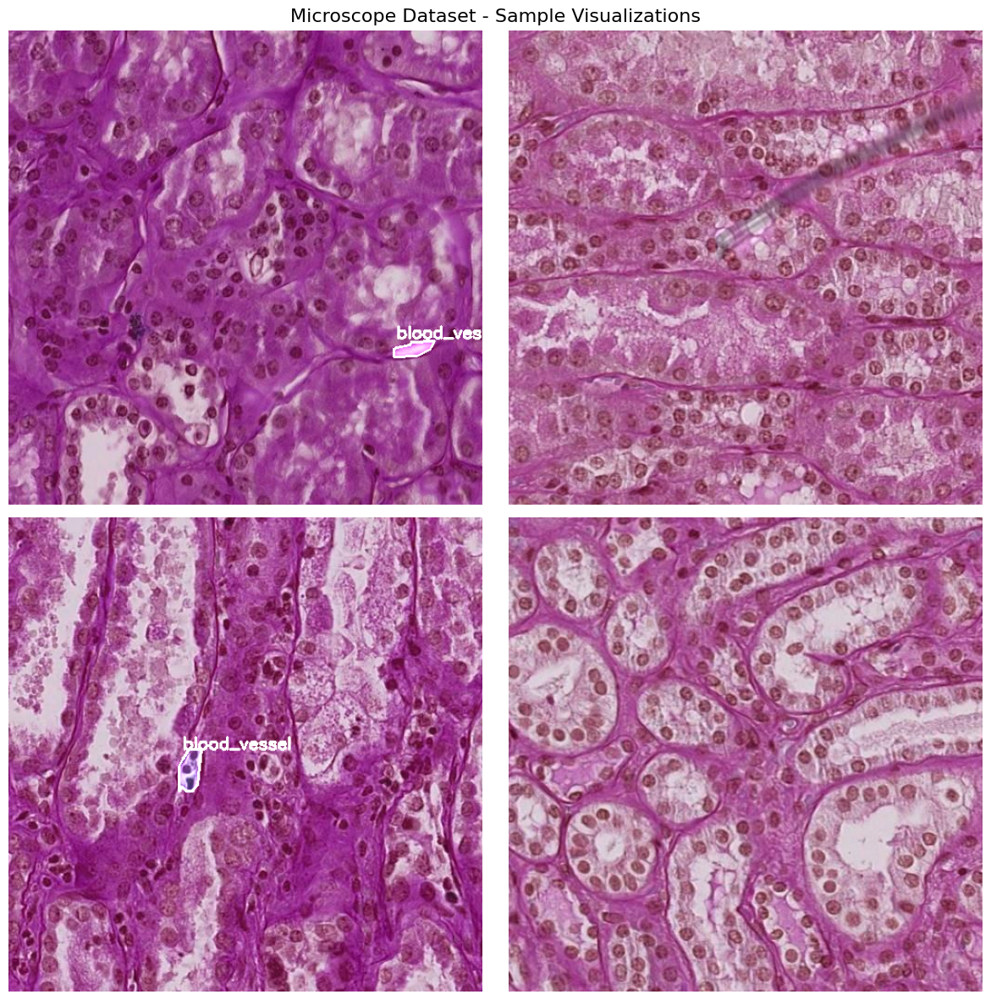

In [12]:
# ============================================================
# Fixed Instance Segmentation Visualization (User-Provided)
# ============================================================

def visualize_image(img_path, label_path, class_names):
    """Visualize one image with segmentation masks or bboxes."""
    img = cv2.imread(img_path)
    if img is None:
        return np.zeros((100, 100, 3), dtype=np.uint8)

    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            lines = f.readlines()

        for line in lines:
            values = list(map(float, line.strip().split()))
            if len(values) < 5:  # must have at least class + coords
                continue

            # ✅ FIXED LINE
            cls_id = int(values[0])    # take only first value
            coords = values[1:]        # remaining values are coordinates

            # Validate class id
            if cls_id < 0 or cls_id >= len(class_names):
                continue

            class_name = class_names[cls_id]
            color = tuple(np.random.randint(0, 255, 3).tolist())

            # Polygon segmentation
            if len(coords) > 4:
                pts = np.array(coords, dtype=np.float32).reshape(-1, 2)
                pts[:, 0] *= w
                pts[:, 1] *= h
                pts = np.round(pts).astype(np.int32)
                pts_reshaped = pts.reshape((-1, 1, 2))

                # Draw filled polygon with transparency
                mask = np.zeros_like(img, dtype=np.uint8)
                cv2.fillPoly(mask, [pts_reshaped], color)
                overlay = cv2.addWeighted(overlay, 1.0, mask, 0.4, 0)
                cv2.polylines(overlay, [pts_reshaped], True, (255, 255, 255), 2)

                # Add label
                x_text, y_text = pts[0]
                cv2.putText(overlay, class_name, (x_text, max(y_text - 10, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

            else:
                # Bounding box fallback
                if len(coords) != 4:
                    continue
                xc, yc, bw, bh = coords
                x1, y1 = int((xc - bw / 2) * w), int((yc - bh / 2) * h)
                x2, y2 = int((xc + bw / 2) * w), int((yc + bh / 2) * h)
                cv2.rectangle(overlay, (x1, y1), (x2, y2), color, 2)
                cv2.putText(overlay, class_name, (x1, max(y1 - 5, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    return overlay


# ====== DISPLAY IMAGES ======
image_files = random.sample(os.listdir(IMAGE_DIR), 4)

plt.figure(figsize=(12, 12))
for idx, img_file in enumerate(image_files):
    img_path = os.path.join(IMAGE_DIR, img_file)
    label_path = os.path.join(LABEL_DIR, img_file.replace(".jpg", ".txt").replace(".png", ".txt"))
    
    vis = visualize_image(img_path, label_path, CLASS_NAMES)
    plt.subplot(2, 2, idx + 1)
    plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    plt.axis("off")

plt.suptitle("Microscope Dataset - Sample Visualizations", fontsize=16)
plt.tight_layout()
plt.show()

## loss function

Training results saved to: /kaggle/working/Microscope-YOLO/run12

Training/Validation Loss Curves:


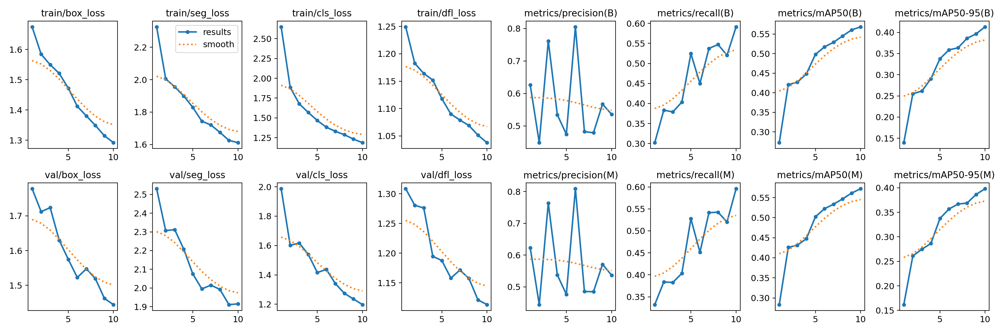


Validation Metrics (Confusion Matrix):


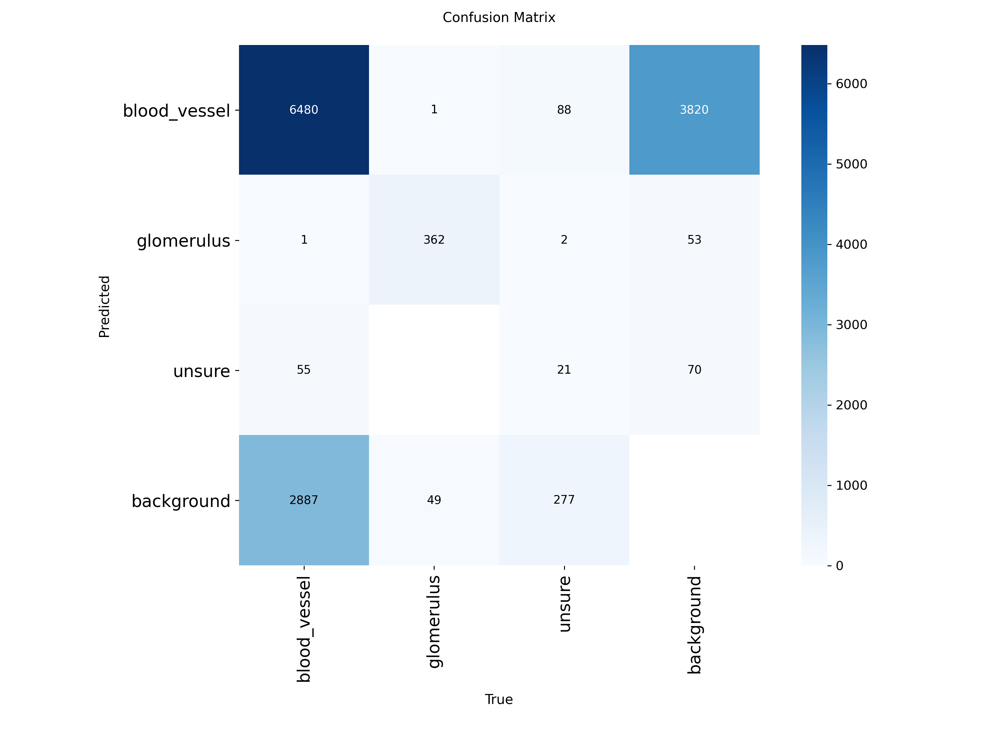

In [15]:
# The 'results' object contains the path to the run
run_dir = results.save_dir  # This gets the directory, e.g., 'Microscope-YOLO/run1'

print(f"Training results saved to: {run_dir}")

# Display the training and validation loss curves
# These are required by the assignment PDF 
print("\nTraining/Validation Loss Curves:")
display(Image(filename=f"{run_dir}/results.png", width=800))

# Display the validation metrics (mAP@0.5, etc.)
# This shows the mAP@0.5 or IoU scores 
print("\nValidation Metrics (Confusion Matrix):")
display(Image(filename=f"{run_dir}/confusion_matrix.png", width=600))

## xai

Selected 4 random test images.

0: 640x640 2 blood_vessels, 7.0ms
1: 640x640 17 blood_vessels, 1 glomerulus, 7.0ms
2: 640x640 (no detections), 7.0ms
3: 640x640 7 blood_vessels, 7.0ms
Speed: 2.2ms preprocess, 7.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
⚠️ No predicted masks found for: /kaggle/input/microscopic-yolov8/test/images/df941ba3ae69_png.rf.2d3a979a09e5f5a86d7d60ca68bd16b2.jpg


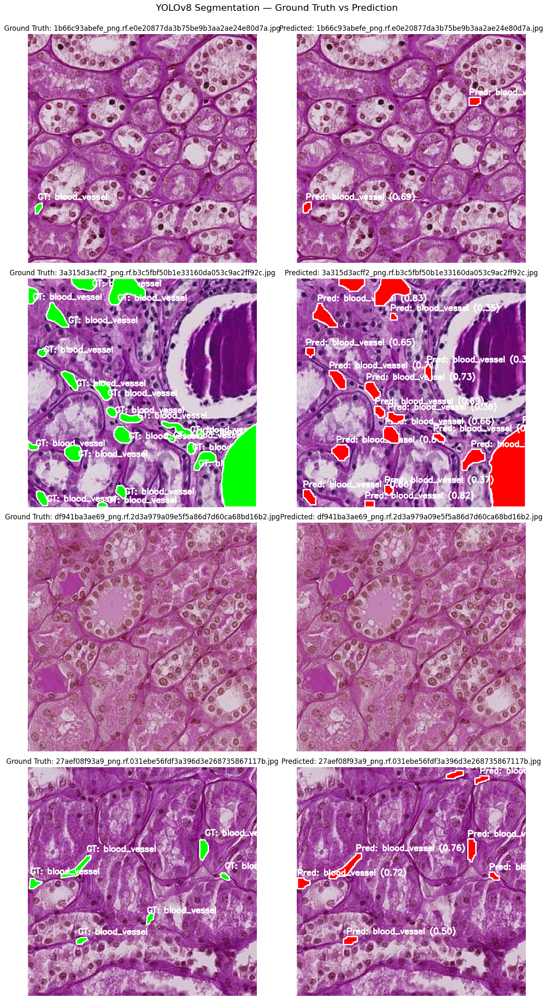

In [20]:
# ============================================================
# YOLOv8 Segmentation — Predicted vs Ground Truth Comparison
# ============================================================
import os
import glob
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO # Make sure YOLO is imported

# --- CONFIGURATION (Corrected for your dataset) ---
TEST_IMAGE_DIR = "/kaggle/input/microscope-dataset/test/images"
TEST_LABEL_DIR = "/kaggle/input/microscope-dataset/test/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

# Ensure the 'model' variable is loaded from your best checkpoint
# (This assumes 'model = YOLO(best_ckpt)' was run in a previous cell)
if 'model' not in globals():
    print("Model not found. Loading 'best.pt' from default 'run1' directory...")
    try:
        run_dir = "/kaggle/working/Microscope-YOLO/run1"
        best_ckpt = os.path.join(run_dir, "weights", "best.pt")
        model = YOLO(best_ckpt)
        print(f"Successfully loaded {best_ckpt}")
    except Exception as e:
        print(f"Error loading model: {e}. Please run the training/validation cells first.")
# ---------------------------------------------------

# Pick a few random test images
sample_imgs = []
if os.path.isdir(TEST_IMAGE_DIR):
    all_imgs = [p for p in glob.glob(os.path.join(TEST_IMAGE_DIR, "*.*"))
                if p.lower().endswith((".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"))]
    
    if len(all_imgs) > 0:
        sample_imgs = random.sample(all_imgs, min(4, len(all_imgs)))
        print(f"Selected {len(sample_imgs)} random test images.")
    else:
        print(f"Error: No images found in {TEST_IMAGE_DIR}")
else:
    print(f"Error: Test directory not found at {TEST_IMAGE_DIR}")

# ------------------------------------------------------------
# Helper to draw polygons from YOLO label file (Ground Truth)
# (Class names default is updated for your dataset)
# ------------------------------------------------------------
def draw_gt_polygons(img_path, label_path, class_names):
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️ Error reading image {img_path}")
        return np.zeros((640, 640, 3), dtype=np.uint8)
        
    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                try:
                    vals = list(map(float, line.strip().split()))
                    cls_id = int(vals[0])
                    coords = vals[1:]
                    if len(coords) > 4:
                        pts = np.array(coords).reshape(-1, 2)
                        pts[:, 0] *= w
                        pts[:, 1] *= h
                        pts = pts.astype(np.int32)
                        color = (0, 255, 0)  # green for GT
                        cv2.fillPoly(overlay, [pts], color)
                        cv2.polylines(overlay, [pts], True, (255, 255, 255), 2)
                        label = class_names[cls_id] if cls_id < len(class_names) else f"ID {cls_id}"
                        cv2.putText(overlay, f"GT: {label}", (pts[0][0], pts[0][1] - 10),
                                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
                except Exception as e:
                    print(f"Error processing line in {label_path}: {e}")
    else:
        print(f"⚠️ No label file found for {os.path.basename(img_path)}")

    return overlay

# ------------------------------------------------------------
# Helper to draw predicted polygons (This function is correct)
# ------------------------------------------------------------
def draw_pred_polygons(result):
    img = result.orig_img.copy()

    if getattr(result, "masks", None) is not None and result.masks is not None:
        for i, seg in enumerate(result.masks.xy):
            poly = np.array(seg, dtype=np.int32)
            color = (0, 0, 255)  # red for predictions
            cv2.fillPoly(img, [poly], color)
            cv2.polylines(img, [poly], True, (255, 255, 255), 2)
            
            if getattr(result, "names", None) is not None and getattr(result.boxes, "cls", None) is not None:
                cls_id = int(result.boxes.cls[i].item())
                conf = float(result.boxes.conf[i].item())
                
                # Get label name
                if isinstance(result.names, dict):
                    label = result.names.get(cls_id, str(cls_id))
                else:
                    label = str(cls_id)
                
                x, y = poly[0]
                cv2.putText(img, f"Pred: {label} ({conf:.2f})", (int(x), int(y) - 6),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
    else:
        print("⚠️ No predicted masks found for:", result.path)

    return img

# ------------------------------------------------------------
# Run inference on test set
# ------------------------------------------------------------
if sample_imgs:
    preds = model.predict(source=sample_imgs, imgsz=640, conf=0.25, save=False)
else:
    preds = []
    print("Skipping prediction as no sample images were found.")

# ------------------------------------------------------------
# Plot Predicted vs Ground Truth
# ------------------------------------------------------------
if preds:
    num_preds = len(preds)
    plt.figure(figsize=(14, 6 * num_preds)) # Adjusted height

    for i, result in enumerate(preds):
        img_path = result.path
        # Construct label path based on test label directory
        label_filename = os.path.basename(img_path).replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(TEST_LABEL_DIR, label_filename)
        
        # Prepare visualizations
        vis_pred = draw_pred_polygons(result)
        
        # ✅ *** CORRECTION HERE ***
        # Pass the correct CLASS_NAMES to the GT function
        vis_gt = draw_gt_polygons(img_path, label_path, CLASS_NAMES)

        vis_pred_rgb = cv2.cvtColor(vis_pred, cv2.COLOR_BGR2RGB)
        vis_gt_rgb = cv2.cvtColor(vis_gt, cv2.COLOR_BGR2RGB)

        # Show side by side
        plt.subplot(num_preds, 2, 2*i + 1)
        plt.imshow(vis_gt_rgb)
        plt.title(f"Ground Truth: {os.path.basename(img_path)}")
        plt.axis("off")

        plt.subplot(num_preds, 2, 2*i + 2)
        plt.imshow(vis_pred_rgb)
        plt.title(f"Predicted: {os.path.basename(img_path)}")
        plt.axis("off")

    # ✅ *** CORRECTION HERE ***
    plt.suptitle("YOLOv8 Segmentation — Ground Truth vs Prediction", fontsize=16, y=1.0)
    plt.tight_layout()
    plt.show()


Scanning test set for class examples...

--- Image Search Report ---
Found 2/2 images for 'blood_vessel'
Found 2/2 images for 'glomerulus'
Found 2/2 images for 'unsure'

Total unique images to predict: 6

0: 640x640 1 glomerulus, 7.6ms
1: 640x640 3 blood_vessels, 1 glomerulus, 7.6ms
2: 640x640 3 blood_vessels, 1 unsure, 7.6ms
3: 640x640 6 blood_vessels, 7.6ms
4: 640x640 9 blood_vessels, 7.6ms
5: 640x640 5 blood_vessels, 1 unsure, 7.6ms
Speed: 2.3ms preprocess, 7.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

--- Plotting 6 comparison images ---


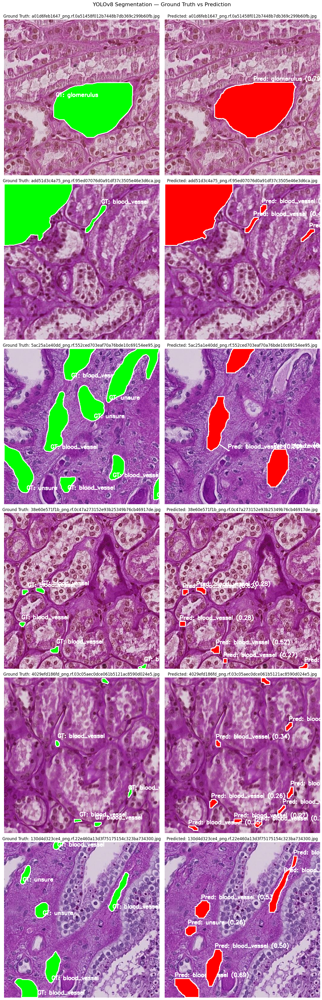

In [21]:
# ============================================================
# YOLOv8 Segmentation — Predicted vs Ground Truth Comparison
# (Finds >= 2 images per class)
# ============================================================
import os
import glob
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO # Make sure YOLO is imported

# --- CONFIGURATION (Corrected for your dataset) ---
TEST_IMAGE_DIR = "/kaggle/input/microscope-dataset/test/images"
TEST_LABEL_DIR = "/kaggle/input/microscope-dataset/test/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']
TARGET_IMAGES_PER_CLASS = 2

# Ensure the 'model' variable is loaded from your best checkpoint
# (This assumes 'model = YOLO(best_ckpt)' was run in a previous cell)
if 'model' not in globals():
    print("Model not found. Loading 'best.pt' from default 'run1' directory...")
    try:
        run_dir = "/kaggle/working/Microscope-YOLO/run1"
        best_ckpt = os.path.join(run_dir, "weights", "best.pt")
        model = YOLO(best_ckpt)
        print(f"Successfully loaded {best_ckpt}")
    except Exception as e:
        print(f"Error loading model: {e}. Please run the training/validation cells first.")
# ---------------------------------------------------

# ------------------------------------------------------------
# NEW: Find at least 2 images per class from the test set
# ------------------------------------------------------------
print("\nScanning test set for class examples...")
class_image_map = {name: [] for name in CLASS_NAMES}
images_to_predict = set() # Use a set to avoid duplicate predictions

all_label_files = []
if os.path.isdir(TEST_LABEL_DIR):
    all_label_files = os.listdir(TEST_LABEL_DIR)
    random.shuffle(all_label_files) # Shuffle to get varied examples
else:
    print(f"Error: Label directory not found at {TEST_LABEL_DIR}")

if all_label_files:
    # Helper to check which classes still need images
    def classes_needed():
        return [name for name, img_list in class_image_map.items() if len(img_list) < TARGET_IMAGES_PER_CLASS]

    # Loop until we find enough images or run out of files
    for label_file in all_label_files:
        needed = classes_needed()
        if not needed:
            #print("Found all required images.")
            break # Stop if all classes have enough images

        label_path = os.path.join(TEST_LABEL_DIR, label_file)
        
        # Find the corresponding image path (handles .jpg, .png, etc.)
        img_name_base = os.path.splitext(label_file)[0]
        img_path = None
        for ext in ['.jpg', '.png', '.jpeg', '.bmp', '.tif', '.tiff']:
            potential_path = os.path.join(TEST_IMAGE_DIR, img_name_base + ext)
            if os.path.exists(potential_path):
                img_path = potential_path
                break
        
        if not img_path:
            continue # Skip if no matching image file

        # Read the label file to find which classes are present
        present_classes = set()
        try:
            with open(label_path, "r") as f:
                for line in f:
                    try:
                        cls_id = int(line.strip().split()[0])
                        if 0 <= cls_id < len(CLASS_NAMES):
                            present_classes.add(CLASS_NAMES[cls_id])
                    except (ValueError, IndexError):
                        continue # Skip bad lines
        except Exception as e:
            #print(f"Error reading {label_file}: {e}")
            continue

        # Add this image to the lists for the classes it contains
        for class_name in present_classes:
            if class_name in needed and len(class_image_map[class_name]) < TARGET_IMAGES_PER_CLASS:
                class_image_map[class_name].append(img_path)
                images_to_predict.add(img_path) # Add to the master set

    # --- Report and assign ---
    print("\n--- Image Search Report ---")
    for class_name, img_list in class_image_map.items():
        print(f"Found {len(img_list)}/{TARGET_IMAGES_PER_CLASS} images for '{class_name}'")

    sample_imgs = list(images_to_predict)
    if not sample_imgs:
        print("Error: No images were found to match classes.")
    
    print(f"\nTotal unique images to predict: {len(sample_imgs)}")

else:
    print("Error: No label files found to scan.")
    sample_imgs = []
    
# ------------------------------------------------------------
# Helper to draw polygons from YOLO label file (Ground Truth)
# (Unchanged)
# ------------------------------------------------------------
def draw_gt_polygons(img_path, label_path, class_names):
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️ Error reading image {img_path}")
        return np.zeros((640, 640, 3), dtype=np.uint8)
        
    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                try:
                    vals = list(map(float, line.strip().split()))
                    cls_id = int(vals[0])
                    coords = vals[1:]
                    if len(coords) > 4:
                        pts = np.array(coords).reshape(-1, 2)
                        pts[:, 0] *= w
                        pts[:, 1] *= h
                        pts = pts.astype(np.int32)
                        color = (0, 255, 0)  # green for GT
                        cv2.fillPoly(overlay, [pts], color)
                        cv2.polylines(overlay, [pts], True, (255, 255, 255), 2)
                        label = class_names[cls_id] if cls_id < len(class_names) else f"ID {cls_id}"
                        cv2.putText(overlay, f"GT: {label}", (pts[0][0], pts[0][1] - 10),
                                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
                except Exception as e:
                    print(f"Error processing line in {label_path}: {e}")
    else:
        print(f"⚠️ No label file found for {os.path.basename(img_path)}")

    return overlay

# ------------------------------------------------------------
# Helper to draw predicted polygons (Unchanged)
# ------------------------------------------------------------
def draw_pred_polygons(result):
    img = result.orig_img.copy()

    if getattr(result, "masks", None) is not None and result.masks is not None:
        for i, seg in enumerate(result.masks.xy):
            poly = np.array(seg, dtype=np.int32)
            color = (0, 0, 255)  # red for predictions
            cv2.fillPoly(img, [poly], color)
            cv2.polylines(img, [poly], True, (255, 255, 255), 2)
            
            if getattr(result, "names", None) is not None and getattr(result.boxes, "cls", None) is not None:
                cls_id = int(result.boxes.cls[i].item())
                conf = float(result.boxes.conf[i].item())
                
                if isinstance(result.names, dict):
                    label = result.names.get(cls_id, str(cls_id))
                else:
                    label = str(cls_id)
                
                x, y = poly[0]
                cv2.putText(img, f"Pred: {label} ({conf:.2f})", (int(x), int(y) - 6),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
    else:
        print("⚠️ No predicted masks found for:", result.path)

    return img

# ------------------------------------------------------------
# Run inference on the selected test images
# ------------------------------------------------------------
if sample_imgs:
    preds = model.predict(source=sample_imgs, imgsz=640, conf=0.25, save=False)
else:
    preds = []
    print("Skipping prediction as no sample images were found.")

# ------------------------------------------------------------
# Plot Predicted vs Ground Truth (Unchanged)
# ------------------------------------------------------------
if preds:
    num_preds = len(preds)
    plt.figure(figsize=(14, 7 * num_preds)) # Adjusted height
    print(f"\n--- Plotting {num_preds} comparison images ---")

    for i, result in enumerate(preds):
        img_path = result.path
        # Construct label path based on test label directory
        label_filename = os.path.basename(img_path).replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(TEST_LABEL_DIR, label_filename)
        
        # Prepare visualizations
        vis_pred = draw_pred_polygons(result)
        vis_gt = draw_gt_polygons(img_path, label_path, CLASS_NAMES)

        vis_pred_rgb = cv2.cvtColor(vis_pred, cv2.COLOR_BGR2RGB)
        vis_gt_rgb = cv2.cvtColor(vis_gt, cv2.COLOR_BGR2RGB)

        # Show side by side
        plt.subplot(num_preds, 2, 2*i + 1)
        plt.imshow(vis_gt_rgb)
        plt.title(f"Ground Truth: {os.path.basename(img_path)}")
        plt.axis("off")

        plt.subplot(num_preds, 2, 2*i + 2)
        plt.imshow(vis_pred_rgb)
        plt.title(f"Predicted: {os.path.basename(img_path)}")
        plt.axis("off")

    plt.suptitle("YOLOv8 Segmentation — Ground Truth vs Prediction", fontsize=16, y=1.0)
    plt.tight_layout()
    plt.show()


Scanning test set for class examples...

--- Image Search Report ---
Found 2/2 images for 'blood_vessel'
Found 2/2 images for 'glomerulus'
Found 2/2 images for 'unsure'

Total unique images to predict: 6

0: 640x640 1 glomerulus, 7.6ms
1: 640x640 3 blood_vessels, 1 glomerulus, 7.6ms
2: 640x640 3 blood_vessels, 1 unsure, 7.6ms
3: 640x640 6 blood_vessels, 7.6ms
4: 640x640 9 blood_vessels, 7.6ms
5: 640x640 5 blood_vessels, 1 unsure, 7.6ms
Speed: 2.3ms preprocess, 7.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

--- Plotting 6 comparison images ---


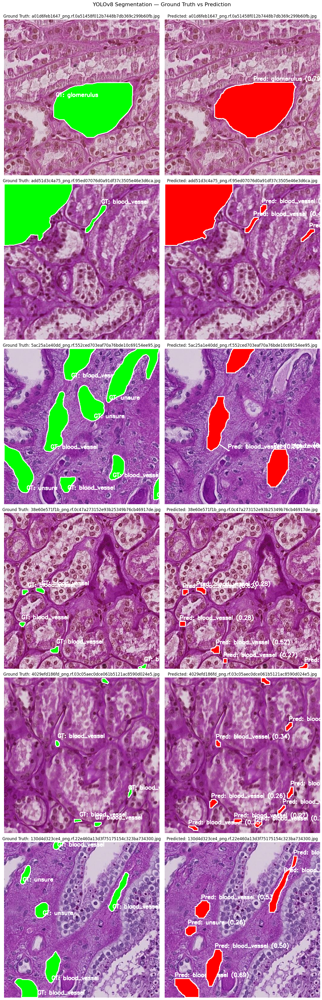

In [21]:
# ============================================================
# YOLOv8 Segmentation — Predicted vs Ground Truth Comparison
# (Finds >= 2 images per class)
# ============================================================
import os
import glob
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO # Make sure YOLO is imported

# --- CONFIGURATION (Corrected for your dataset) ---
TEST_IMAGE_DIR = "/kaggle/input/microscopic-yolov8/test/images"
TEST_LABEL_DIR = "/kaggle/input/microscopic-yolov8/test/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']
TARGET_IMAGES_PER_CLASS = 2

# Ensure the 'model' variable is loaded from your best checkpoint
# (This assumes 'model = YOLO(best_ckpt)' was run in a previous cell)
if 'model' not in globals():
    print("Model not found. Loading 'best.pt' from default 'run1' directory...")
    try:
        run_dir = "/kaggle/working/Microscope-YOLO/run1"
        best_ckpt = os.path.join(run_dir, "weights", "best.pt")
        model = YOLO(best_ckpt)
        print(f"Successfully loaded {best_ckpt}")
    except Exception as e:
        print(f"Error loading model: {e}. Please run the training/validation cells first.")
# ---------------------------------------------------

# ------------------------------------------------------------
# NEW: Find at least 2 images per class from the test set
# ------------------------------------------------------------
print("\nScanning test set for class examples...")
class_image_map = {name: [] for name in CLASS_NAMES}
images_to_predict = set() # Use a set to avoid duplicate predictions

all_label_files = []
if os.path.isdir(TEST_LABEL_DIR):
    all_label_files = os.listdir(TEST_LABEL_DIR)
    random.shuffle(all_label_files) # Shuffle to get varied examples
else:
    print(f"Error: Label directory not found at {TEST_LABEL_DIR}")

if all_label_files:
    # Helper to check which classes still need images
    def classes_needed():
        return [name for name, img_list in class_image_map.items() if len(img_list) < TARGET_IMAGES_PER_CLASS]

    # Loop until we find enough images or run out of files
    for label_file in all_label_files:
        needed = classes_needed()
        if not needed:
            #print("Found all required images.")
            break # Stop if all classes have enough images

        label_path = os.path.join(TEST_LABEL_DIR, label_file)
        
        # Find the corresponding image path (handles .jpg, .png, etc.)
        img_name_base = os.path.splitext(label_file)[0]
        img_path = None
        for ext in ['.jpg', '.png', '.jpeg', '.bmp', '.tif', '.tiff']:
            potential_path = os.path.join(TEST_IMAGE_DIR, img_name_base + ext)
            if os.path.exists(potential_path):
                img_path = potential_path
                break
        
        if not img_path:
            continue # Skip if no matching image file

        # Read the label file to find which classes are present
        present_classes = set()
        try:
            with open(label_path, "r") as f:
                for line in f:
                    try:
                        cls_id = int(line.strip().split()[0])
                        if 0 <= cls_id < len(CLASS_NAMES):
                            present_classes.add(CLASS_NAMES[cls_id])
                    except (ValueError, IndexError):
                        continue # Skip bad lines
        except Exception as e:
            #print(f"Error reading {label_file}: {e}")
            continue

        # Add this image to the lists for the classes it contains
        for class_name in present_classes:
            if class_name in needed and len(class_image_map[class_name]) < TARGET_IMAGES_PER_CLASS:
                class_image_map[class_name].append(img_path)
                images_to_predict.add(img_path) # Add to the master set

    # --- Report and assign ---
    print("\n--- Image Search Report ---")
    for class_name, img_list in class_image_map.items():
        print(f"Found {len(img_list)}/{TARGET_IMAGES_PER_CLASS} images for '{class_name}'")

    sample_imgs = list(images_to_predict)
    if not sample_imgs:
        print("Error: No images were found to match classes.")
    
    print(f"\nTotal unique images to predict: {len(sample_imgs)}")

else:
    print("Error: No label files found to scan.")
    sample_imgs = []
    
# ------------------------------------------------------------
# Helper to draw polygons from YOLO label file (Ground Truth)
# (Unchanged)
# ------------------------------------------------------------
def draw_gt_polygons(img_path, label_path, class_names):
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️ Error reading image {img_path}")
        return np.zeros((640, 640, 3), dtype=np.uint8)
        
    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                try:
                    vals = list(map(float, line.strip().split()))
                    cls_id = int(vals[0])
                    coords = vals[1:]
                    if len(coords) > 4:
                        pts = np.array(coords).reshape(-1, 2)
                        pts[:, 0] *= w
                        pts[:, 1] *= h
                        pts = pts.astype(np.int32)
                        color = (0, 255, 0)  # green for GT
                        cv2.fillPoly(overlay, [pts], color)
                        cv2.polylines(overlay, [pts], True, (255, 255, 255), 2)
                        label = class_names[cls_id] if cls_id < len(class_names) else f"ID {cls_id}"
                        cv2.putText(overlay, f"GT: {label}", (pts[0][0], pts[0][1] - 10),
                                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
                except Exception as e:
                    print(f"Error processing line in {label_path}: {e}")
    else:
        print(f"⚠️ No label file found for {os.path.basename(img_path)}")

    return overlay

# ------------------------------------------------------------
# Helper to draw predicted polygons (Unchanged)
# ------------------------------------------------------------
def draw_pred_polygons(result):
    img = result.orig_img.copy()

    if getattr(result, "masks", None) is not None and result.masks is not None:
        for i, seg in enumerate(result.masks.xy):
            poly = np.array(seg, dtype=np.int32)
            color = (0, 0, 255)  # red for predictions
            cv2.fillPoly(img, [poly], color)
            cv2.polylines(img, [poly], True, (255, 255, 255), 2)
            
            if getattr(result, "names", None) is not None and getattr(result.boxes, "cls", None) is not None:
                cls_id = int(result.boxes.cls[i].item())
                conf = float(result.boxes.conf[i].item())
                
                if isinstance(result.names, dict):
                    label = result.names.get(cls_id, str(cls_id))
                else:
                    label = str(cls_id)
                
                x, y = poly[0]
                cv2.putText(img, f"Pred: {label} ({conf:.2f})", (int(x), int(y) - 6),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
    else:
        print("⚠️ No predicted masks found for:", result.path)

    return img

# ------------------------------------------------------------
# Run inference on the selected test images
# ------------------------------------------------------------
if sample_imgs:
    preds = model.predict(source=sample_imgs, imgsz=640, conf=0.25, save=False)
else:
    preds = []
    print("Skipping prediction as no sample images were found.")

# ------------------------------------------------------------
# Plot Predicted vs Ground Truth (Unchanged)
# ------------------------------------------------------------
if preds:
    num_preds = len(preds)
    plt.figure(figsize=(14, 7 * num_preds)) # Adjusted height
    print(f"\n--- Plotting {num_preds} comparison images ---")

    for i, result in enumerate(preds):
        img_path = result.path
        # Construct label path based on test label directory
        label_filename = os.path.basename(img_path).replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(TEST_LABEL_DIR, label_filename)
        
        # Prepare visualizations
        vis_pred = draw_pred_polygons(result)
        vis_gt = draw_gt_polygons(img_path, label_path, CLASS_NAMES)

        vis_pred_rgb = cv2.cvtColor(vis_pred, cv2.COLOR_BGR2RGB)
        vis_gt_rgb = cv2.cvtColor(vis_gt, cv2.COLOR_BGR2RGB)

        # Show side by side
        plt.subplot(num_preds, 2, 2*i + 1)
        plt.imshow(vis_gt_rgb)
        plt.title(f"Ground Truth: {os.path.basename(img_path)}")
        plt.axis("off")

        plt.subplot(num_preds, 2, 2*i + 2)
        plt.imshow(vis_pred_rgb)
        plt.title(f"Predicted: {os.path.basename(img_path)}")
        plt.axis("off")

    plt.suptitle("YOLOv8 Segmentation — Ground Truth vs Prediction", fontsize=16, y=1.0)
    plt.tight_layout()
    plt.show()

#

# yolo12 model

## Load the assigned dataset 

In [1]:
import os, sys, math
from pathlib import Path
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage import exposure, img_as_ubyte
from skimage.color import rgb2gray
%matplotlib inline

In [3]:
def show_images(imgs, titles=None, figsize=(15,5)):
    n = len(imgs)
    plt.figure(figsize=figsize)
    for i,img in enumerate(imgs):
        plt.subplot(1,n,i+1)
        if img.ndim==2:
            plt.imshow(img, cmap='gray')
        else:
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        if titles: plt.title(titles[i])
        plt.axis('off')
    plt.tight_layout()

In [4]:
DATA_DIR = "/kaggle/input/microscope-dataset/train/images"
img_files = sorted([str(p) for p in Path(DATA_DIR).glob("*")])[:50]
samples = img_files[:3]
samples

['/kaggle/input/microscope-dataset/train/images/0006ff2aa7cd_png.rf.bb7fc116f8d3c650cb810eb51b5745bd.jpg',
 '/kaggle/input/microscope-dataset/train/images/000e79e206b7_png.rf.6e4403f08b29496fae327b06dd111918.jpg',
 '/kaggle/input/microscope-dataset/train/images/00168d1b7522_png.rf.f735c6165d4a73aad34b3b5f97870d92.jpg']

##  any three sample images.

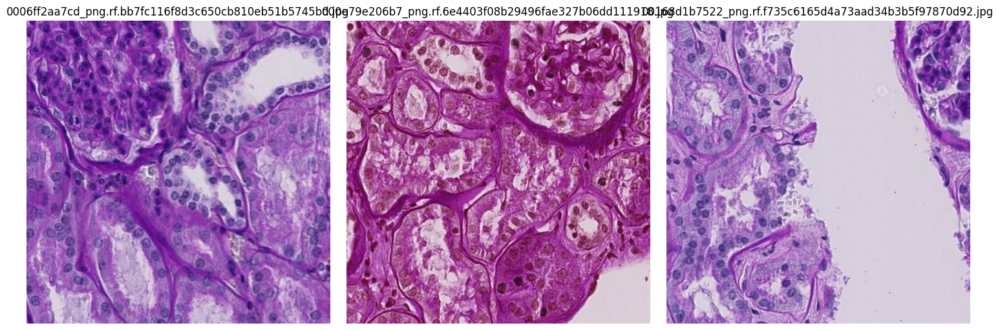

In [5]:
def read_img(p):
    img = cv2.imread(p, cv2.IMREAD_COLOR)
    if img is None:
        raise FileNotFoundError(p)
    return img

imgs = [read_img(p) for p in samples]
show_images(imgs, titles=[Path(p).name for p in samples])

## intensity transformation

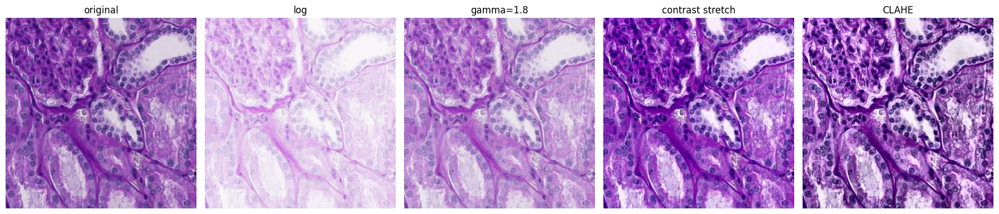

In [7]:
def log_transform(img):
    img_f = img.astype(np.float32) + 1.0
    c = 255 / np.log(1 + np.max(img_f))
    out = c * np.log(img_f)
    return np.clip(out,0,255).astype(np.uint8)

def gamma_correction(img, gamma=1.2):
    invGamma = 1.0 / gamma
    table = (np.arange(0,256) / 255.0) ** invGamma * 255
    table = np.clip(table,0,255).astype("uint8")
    return cv2.LUT(img, table)

def contrast_stretch(img):
    p2, p98 = np.percentile(img, (2, 98))
    out = exposure.rescale_intensity(img, in_range=(p2, p98))
    return img_as_ubyte(out)

def clahe_rgb(img, clipLimit=2.0, tileGridSize=(8,8)):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
    cl = clahe.apply(l)
    limg = cv2.merge((cl,a,b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

# apply and display for one sample
s = imgs[0]
transformed = [
    s,
    log_transform(s),
    gamma_correction(s, gamma=1.8),
    contrast_stretch(s),
    clahe_rgb(s)
]
titles = ['original','log','gamma=1.8','contrast stretch','CLAHE']
show_images(transformed, titles=titles, figsize=(18,6))

##  filtering operations

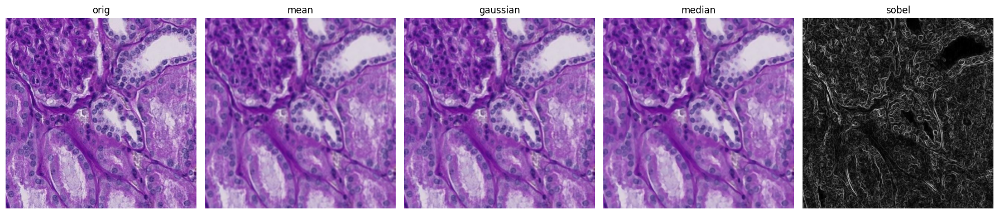

In [8]:
def mean_filter(img, k=5):
    return cv2.blur(img, (k,k))

def gaussian_blur(img, k=5):
    return cv2.GaussianBlur(img,(k,k),0)

def median_filter(img, k=5):
    return cv2.medianBlur(img, k)

def sobel_edge(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sx = cv2.Sobel(gray, cv2.CV_64F,1,0,ksize=3)
    sy = cv2.Sobel(gray, cv2.CV_64F,0,1,ksize=3)
    mag = np.sqrt(sx**2 + sy**2)
    mag = (255 * (mag / np.max(mag))).astype(np.uint8)
    return mag

# display filters
fimgs = [
    s,
    mean_filter(s,5),
    gaussian_blur(s,5),
    median_filter(s,5),
    cv2.cvtColor(sobel_edge(s), cv2.COLOR_GRAY2BGR)
]
ftitles = ['orig','mean','gaussian','median','sobel']
show_images(fimgs, titles=ftitles, figsize=(18,6))

## Instance Segmentation with yolo12

In [9]:
%%writefile /kaggle/working/data.yaml

train:/kaggle/input/microscope-dataset/train/images
val: /kaggle/input/microscope-dataset/valid/images
test:/kaggle/input/microscope-dataset/test/images


nc: 3
names: ['blood_vessel', 'glomerulus', 'unsure']


Writing /kaggle/working/data.yaml


In [10]:
!pip install ultralytics --no-deps

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 52.1 MB/s eta 0:00:00


In [11]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import yaml, json, os, random, cv2, glob
import numpy as np
from pathlib import Path
import pandas as pd

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [12]:
DATASET_ROOT = '/kaggle/input/microscope-dataset'
IMAGES_TRAIN = os.path.join(DATASET_ROOT, 'train', 'images')
IMAGES_VAL = os.path.join(DATASET_ROOT, 'valid', 'images')
IMAGES_TEST = os.path.join(DATASET_ROOT, 'test', 'images')

LABELS_TRAIN = os.path.join(DATASET_ROOT, 'train', 'labels')
LABELS_VAL = os.path.join(DATASET_ROOT, 'valid', 'labels')
LABELS_TEST = os.path.join(DATASET_ROOT, 'test', 'labels')

CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

In [13]:
def validate_images(img_dir, label_dir, max_check=100):
    """Check for corrupted images and remove them with their labels."""
    img_files = glob.glob(os.path.join(img_dir, "*.*"))
    img_files = [f for f in img_files if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]
    
    corrupted = []
    print(f"Checking {min(max_check, len(img_files))} images in {img_dir}...")
    
    for i, img_path in enumerate(img_files[:max_check]):
        try:
            img = cv2.imread(img_path)
            if img is None:
                corrupted.append(img_path)
                print(f"Corrupted: {os.path.basename(img_path)}")
        except Exception as e:
            corrupted.append(img_path)
            print(f"Error reading {os.path.basename(img_path)}: {e}")
    
    print(f"Found {len(corrupted)} corrupted images out of {min(max_check, len(img_files))} checked")
    return corrupted

print("=" * 60)
print("VALIDATING DATASET")
print("=" * 60)
corrupted_train = validate_images(IMAGES_TRAIN, LABELS_TRAIN, max_check=100)
corrupted_val = validate_images(IMAGES_VAL, LABELS_VAL, max_check=50)

VALIDATING DATASET
Checking 100 images in /kaggle/input/microscope-dataset/train/images...
Found 0 corrupted images out of 100 checked
Checking 50 images in /kaggle/input/microscope-dataset/valid/images...
Found 0 corrupted images out of 50 checked


In [14]:
import yaml, os

yaml_path = '/kaggle/working/data.yaml'

# Define dataset info
DATASET_ROOT = '/kaggle/input/microscope-dataset'  # update if needed
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

# Define your image size
IMAGE_SIZE = 640

# Create the YAML dictionary
DATA_YAML = {
    'path': DATASET_ROOT,
    'train': 'train/images',
    'val': 'valid/images',
    'test': 'test/images',
    'nc': len(CLASS_NAMES),
    'names': CLASS_NAMES,
    'image_size': {
        'train': IMAGE_SIZE,
        'valid': IMAGE_SIZE,
        'test': IMAGE_SIZE
    }
}

# Write YAML file
with open(yaml_path, 'w') as f:
    yaml.dump(DATA_YAML, f, sort_keys=False)

# Optional: print debug info
print("\n" + "=" * 60)
print("DATA CONFIGURATION")
print("=" * 60)
print(f"YAML path: {yaml_path}")
print(f"Train images exist: {os.path.exists(os.path.join(DATASET_ROOT, 'train/images'))}")
print(f"Val images exist: {os.path.exists(os.path.join(DATASET_ROOT, 'valid/images'))}")
print(f"Test images exist: {os.path.exists(os.path.join(DATASET_ROOT, 'test/images'))}")



DATA CONFIGURATION
YAML path: /kaggle/working/data.yaml
Train images exist: True
Val images exist: True
Test images exist: True


In [15]:
model = YOLO('yolo12n-seg.yaml').load("yolo12n.pt")

print("\n" + "=" * 60)
print("STARTING TRAINING")
print("=" * 60)

try:
    results = model.train(
        data=yaml_path,
        epochs=30,            
        imgsz=640,
        batch=8,              
        workers=2,
        device=0,             
        patience=5,        
        save=True,
        save_period=-1,       
        pretrained=True,
        optimizer="auto",
        project="/kaggle/working/yolo12_runs",
        name="detect_yolo12_seg",
        exist_ok=True,
        amp=True  
    )
    print("\nTraining completed successfully!")
    print(f"Results saved to: {results.save_dir}")
except Exception as e:
    print(f"\nTraining failed with error:")
    print(f"{type(e).__name__}: {e}")
    raise

Transferred 691/753 items from pretrained weights

STARTING TRAINING
Ultralytics 8.3.223 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12n-seg.yaml, momentum=0.937, mosaic=1.0, multi_scale=False, name=detect_yolo12_seg, nbs=64, nms=False, opset=None, optimize=

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1398      10223      0.586      0.617      0.601       0.45      0.591      0.613      0.604      0.432
          blood_vessel       1231       9423      0.601      0.733      0.708        0.4       0.61      0.732       0.71      0.351
            glomerulus        361        412      0.862      0.913      0.933      0.854      0.863       0.91      0.934      0.853
                unsure        156        388      0.294      0.205      0.161     0.0956      0.301      0.196      0.168     0.0923
Speed: 0.2ms preprocess, 4.0ms inference, 0.0ms loss, 3.3ms postprocess per image
Results saved to /kaggle/working/yolo12_runs/detect_yolo12_seg

Training completed successfully!
Results saved to: /kaggle/working/yolo12_runs/detect_yolo12_seg


In [21]:
print("\n" + "=" * 60)
print("VALIDATION METRICS")
print("=" * 60)

run_dir = results.save_dir if hasattr(results, "save_dir") else "/kaggle/working/yolo12_runs/detect_yolo12_seg"
best_ckpt = os.path.join(run_dir, "weights", "best.pt")

if os.path.exists(best_ckpt):
    print(f"Loading best weights: {best_ckpt}")
    model = YOLO(best_ckpt)
    
    val_metrics = model.val(split="val")
    
    print(f"\nValidation Results:")
    print(f"  Box mAP50-95: {val_metrics.box.map:.4f}")
    print(f"  Box mAP50: {val_metrics.box.map50:.4f}")
    print(f"  Mask mAP50-95: {val_metrics.seg.map:.4f}")
    print(f"  Mask mAP50: {val_metrics.seg.map50:.4f}")
else:
    print("Best checkpoint not found!")


VALIDATION METRICS
Loading best weights: /kaggle/working/yolo12_runs/detect_yolo12_seg/weights/best.pt
Ultralytics 8.3.223 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO12n-seg summary (fused): 172 layers, 2,809,729 parameters, 0 gradients
val: Fast image access ✅ (ping: 0.2±0.4 ms, read: 57.1±4.6 MB/s, size: 59.0 KB)
val: Scanning /kaggle/input/microscope-dataset/valid/labels... 1398 images, 141 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 1398/1398 450.7it/s 3.1s0.0s
val: /kaggle/input/microscope-dataset/valid/images/0bc3e1a729e4_png.rf.83f054024af970ebc8d1fc2c5334988a.jpg: 7 duplicate labels removed
val: /kaggle/input/microscope-dataset/valid/images/0ce440ad7080_png.rf.e3f901797e8bb649f7bc46340a9c31f0.jpg: 13 duplicate labels removed
val: /kaggle/input/microscope-dataset/valid/images/0f6e1cb07f74_png.rf.c02f7fcd1a04b15ac08916796fd41cc5.jpg: 8 duplicate labels removed
val: /kaggle/input/microscope-dataset/valid/images/1b5da995f08e_png.rf.6c3eabec5383984

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1398      10223      0.584      0.618      0.601       0.45       0.59      0.612      0.603       0.43
          blood_vessel       1231       9423      0.598      0.735      0.708        0.4      0.608      0.731      0.708      0.346
            glomerulus        361        412      0.862      0.913      0.933      0.854      0.862       0.91      0.935      0.851
                unsure        156        388      0.291      0.206      0.161     0.0959      0.299      0.196      0.167     0.0917
Speed: 1.3ms preprocess, 4.2ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to /kaggle/working/runs/segment/val6

Validation Results:
  Box mAP50-95: 0.4498
  Box mAP50: 0.6008
  Mask mAP50-95: 0.4299
  Mask mAP50: 0.6035


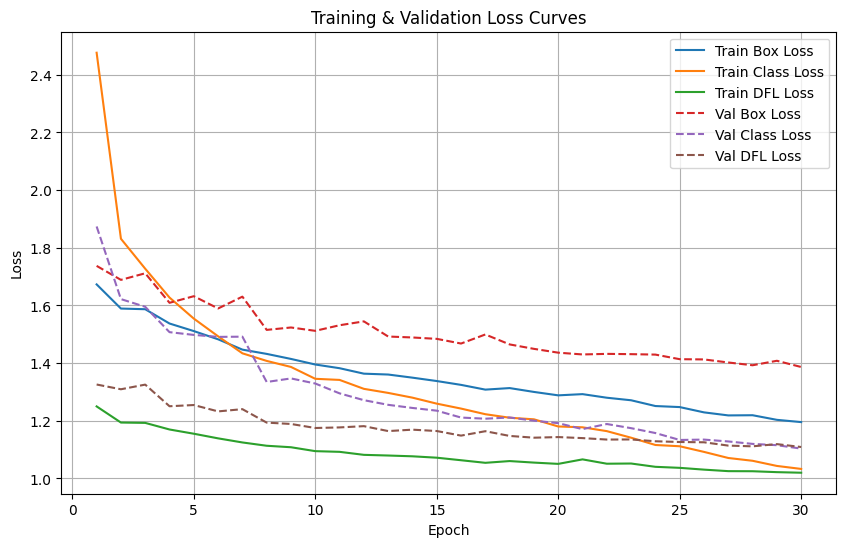

In [22]:
results_dir = '/kaggle/working/yolo12_runs/detect_yolo12_seg'

results_csv = os.path.join(results_dir, "results.csv")
results = pd.read_csv(results_csv)

# Plot key losses
plt.figure(figsize=(10, 6))
plt.plot(results["epoch"], results["train/box_loss"], label="Train Box Loss")
plt.plot(results["epoch"], results["train/cls_loss"], label="Train Class Loss")
plt.plot(results["epoch"], results["train/dfl_loss"], label="Train DFL Loss")
plt.plot(results["epoch"], results["val/box_loss"], '--', label="Val Box Loss")
plt.plot(results["epoch"], results["val/cls_loss"], '--', label="Val Class Loss")
plt.plot(results["epoch"], results["val/dfl_loss"], '--', label="Val DFL Loss")

plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training & Validation Loss Curves")
plt.legend()
plt.grid(True)
plt.show()

In [23]:

print("\n" + "=" * 60)
print("TEST INFERENCE")
print("=" * 60)
    
test_img_dir = os.path.join(DATASET_ROOT, 'test', 'images')
test_imgs = glob.glob(os.path.join(test_img_dir, '*.*'))
test_imgs = [f for f in test_imgs if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    
if len(test_imgs) > 0:
    sample_imgs = random.sample(test_imgs, min(6, len(test_imgs)))
        
    print(f"Running inference on {len(sample_imgs)} test images...")
    predictions = model.predict(
        source=sample_imgs,
        imgsz=640,
        conf=0.25,
        verbose=False,
        save=False
    )
        


TEST INFERENCE
Running inference on 6 test images...


In [28]:
import cv2
import numpy as np

def draw_gt_polygons(img_path, label_path, class_names):
    """
    Draw YOLO-format segmentation ground truth polygons on an image.
    """
    img = cv2.imread(img_path)
    if img is None:
        raise FileNotFoundError(f"Image not found: {img_path}")
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    if not os.path.exists(label_path):
        print(f"[WARN] Label file not found: {label_path}")
        return img

    with open(label_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        parts = line.strip().split()
        if len(parts) < 3:
            continue
        cls_id = int(parts[0])
        coords = np.array(list(map(float, parts[1:])))
        # YOLO segmentation labels are normalized x1 y1 x2 y2 ...
        pts = coords.reshape(-1, 2)
        pts[:, 0] *= w
        pts[:, 1] *= h
        pts = pts.astype(np.int32)

        color = tuple(np.random.randint(0, 255, 3).tolist())
        cv2.polylines(img, [pts], isClosed=True, color=color, thickness=2)
        label = class_names[cls_id] if cls_id < len(class_names) else str(cls_id)
        cv2.putText(img, label, tuple(pts[0]), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)

    return img


def draw_pred_polygons(result):
    """
    Draw predicted segmentation polygons from a YOLOv8/v12 result object.
    """
    img = result.orig_img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if hasattr(result, 'masks') and result.masks is not None:
        for mask, cls_id in zip(result.masks.xy, result.boxes.cls):
            pts = np.array(mask, dtype=np.int32)
            color = tuple(np.random.randint(0, 255, 3).tolist())
            cv2.polylines(img, [pts], isClosed=True, color=color, thickness=2)
            label = result.names[int(cls_id)] if hasattr(result, 'names') else str(int(cls_id))
            cv2.putText(img, label, tuple(pts[0]), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)

    return img


PREDICTION AND VISUALIZATION
Running inference on 4 test images...


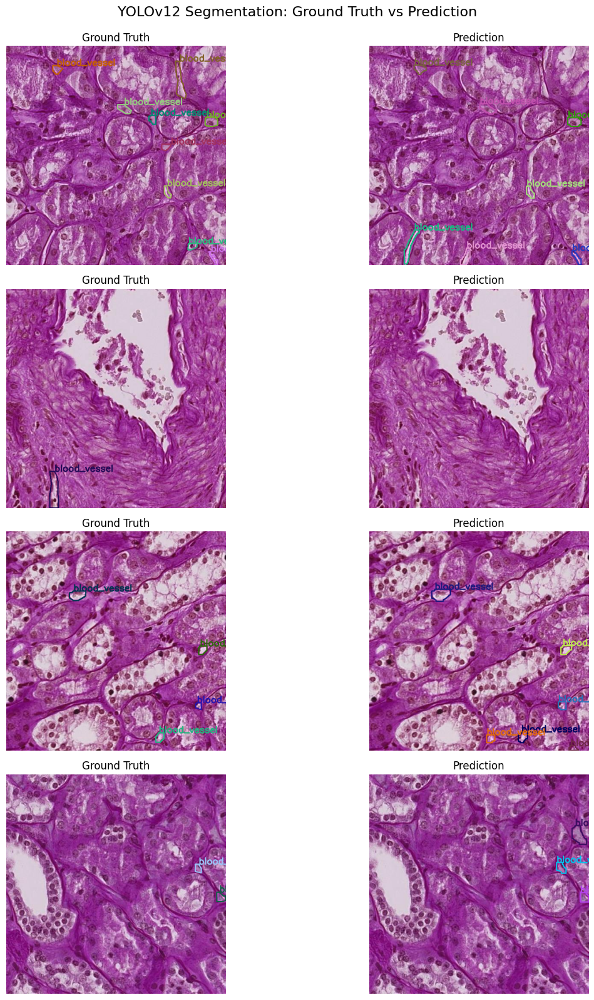

In [29]:
print("\n" + "=" * 60)
print("PREDICTION AND VISUALIZATION")
print("=" * 60)

test_imgs = glob.glob(os.path.join(IMAGES_TEST, "*.*"))
test_imgs = [f for f in test_imgs if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
sample_imgs = random.sample(test_imgs, min(4, len(test_imgs)))

print(f"Running inference on {len(sample_imgs)} test images...")
preds = model.predict(source=sample_imgs, imgsz=640, conf=0.25, save=False, verbose=False)

fig, axes = plt.subplots(len(preds), 2, figsize=(14, 4 * len(preds)))
if len(preds) == 1:
    axes = axes.reshape(1, -1)

for i, result in enumerate(preds):
    img_path = result.path
    label_path = os.path.join(LABELS_TEST, 
                              os.path.basename(img_path).rsplit('.', 1)[0] + '.txt')
    
    vis_gt = draw_gt_polygons(img_path, label_path, CLASS_NAMES)
    vis_pred = draw_pred_polygons(result)
    
    axes[i, 0].imshow(vis_gt)
    axes[i, 0].set_title("Ground Truth", fontsize=12)
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(vis_pred)
    axes[i, 1].set_title("Prediction", fontsize=12)
    axes[i, 1].axis('off')

plt.suptitle("YOLOv12 Segmentation: Ground Truth vs Prediction", fontsize=16, y=0.995)
plt.tight_layout()
plt.show()
